# 2.Exploratory Data Analysis (EDA)

### Import relevent Libaries

In [1]:
#pip install folium


In [2]:
#pip install plotly


In [3]:
#pip install matplotlib

In [4]:
#pip install pandas==1.2.5

In [5]:
#pip install --upgrade pandas

In [6]:
#pip install seaborn --upgrade

In [7]:
#pip install daal==2021.2.3

In [8]:
#pip install ydata-profiling --upgrade

In [9]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale

import folium
import geopandas as gpd
from shapely.geometry import Point
from geopy.distance import geodesic
from geopy.geocoders import Nominatim
import math
from math import radians, sin, cos, sqrt, atan2
import plotly.graph_objects as go

from sklearn.cluster import AgglomerativeClustering as AC

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)


### Source and load the data

In [10]:
cleanfilepath = "../data/interim/crime_data.csv"
crimedata = pd.read_csv(cleanfilepath,index_col =0)

#### Crime data from 2010 to 2022

In [11]:
crimedata.head(3)

,DATE_OCC,TIME_OCC,AREA,AREA_NAME,RPT_DIST_NO,PART_1-2,CRM_CD,CRM_CD_DESC,MOCODES,VICT_AGE,...,LAT,LON,MTH_RPTD,DAY_RPTD,YEAR_RPTD,MTH_OCC,DAY_OCC,YEAR_OCC,ID,WEEKDAY_OCC
DATE_RPTD,,,,,,,,,,,,,,,,,,,,,
2019-07-31,2010-01-01,900,21,Topanga,2175,2,354,THEFT OF IDENTITY,0377,48,...,34.1720,-118.6084,7,31,2019,1,1,2010,1,Friday
2011-07-21,2010-01-01,800,11,Northeast,1112,2,354,THEFT OF IDENTITY,NaN,55,...,34.1259,-118.2244,7,21,2011,1,1,2010,2,Friday
2014-06-30,2010-01-01,800,21,Topanga,2136,1,820,ORAL COPULATION,1258 0512,7,...,34.2010,-118.5955,6,30,2014,1,1,2010,3,Friday


In [12]:
crimedata.dtypes

DATE_OCC           object
TIME_OCC            int64
AREA                int64
AREA_NAME          object
RPT_DIST_NO         int64
PART_1-2            int64
CRM_CD              int64
CRM_CD_DESC        object
MOCODES            object
VICT_AGE            int64
VICT_SEX           object
VICT_DESCENT       object
PREMIS_CD         float64
PREMIS_DESC        object
WEAPON_USED_CD    float64
WEAPON_DESC        object
STATUS             object
STATUS_DESC        object
CRM_CD_1          float64
LOCATION           object
LAT               float64
LON               float64
MTH_RPTD            int64
DAY_RPTD            int64
YEAR_RPTD           int64
MTH_OCC             int64
DAY_OCC             int64
YEAR_OCC            int64
ID                  int64
WEEKDAY_OCC        object
dtype: object

In [13]:
crimedata.describe()

,TIME_OCC,AREA,RPT_DIST_NO,PART_1-2,CRM_CD,VICT_AGE,PREMIS_CD,WEAPON_USED_CD,CRM_CD_1,LAT,LON,MTH_RPTD,DAY_RPTD,YEAR_RPTD,MTH_OCC,DAY_OCC,YEAR_OCC,ID
count,2.865898e+06,2.865898e+06,2.865898e+06,2.865898e+06,2.865898e+06,2.865898e+06,2.865842e+06,973107.000000,2.865898e+06,2.865898e+06,2.865898e+06,2.865898e+06,2.865898e+06,2.865898e+06,2.865898e+06,2.865898e+06,2.865898e+06,2.865898e+06
mean,1.353032e+03,1.089509e+01,1.135897e+03,1.437166e+00,5.054080e+02,3.127953e+01,3.098842e+02,369.015171,5.052045e+02,3.403931e+01,-1.182288e+02,6.428508e+00,1.573869e+01,2.016554e+03,6.409296e+00,1.544798e+01,2.016501e+03,1.432950e+06
std,6.490993e+02,6.000381e+00,6.000197e+02,4.960363e-01,2.099921e+02,2.095885e+01,2.129401e+02,116.433867,2.098366e+02,1.126499e+00,3.893833e+00,3.400382e+00,8.800544e+00,3.945722e+00,3.413302e+00,8.931672e+00,3.947247e+00,8.273136e+05
min,1.000000e+00,1.000000e+00,1.000000e+02,1.000000e+00,1.100000e+02,-1.200000e+01,1.010000e+02,101.000000,-1.000000e+00,0.000000e+00,-1.188279e+02,1.000000e+00,1.000000e+00,2.010000e+03,1.000000e+00,1.000000e+00,2.010000e+03,1.000000e+00
25%,9.200000e+02,6.000000e+00,6.360000e+02,1.000000e+00,3.300000e+02,1.900000e+01,1.020000e+02,400.000000,3.300000e+02,3.401080e+01,-1.184333e+02,4.000000e+00,8.000000e+00,2.013000e+03,3.000000e+00,8.000000e+00,2.013000e+03,7.164752e+05
50%,1.430000e+03,1.100000e+01,1.162000e+03,1.000000e+00,4.420000e+02,3.100000e+01,2.100000e+02,400.000000,4.420000e+02,3.406090e+01,-1.183267e+02,6.000000e+00,1.600000e+01,2.017000e+03,6.000000e+00,1.500000e+01,2.017000e+03,1.432950e+06
75%,1.900000e+03,1.600000e+01,1.638000e+03,2.000000e+00,6.260000e+02,4.600000e+01,5.010000e+02,400.000000,6.260000e+02,3.417090e+01,-1.182761e+02,9.000000e+00,2.300000e+01,2.020000e+03,9.000000e+00,2.300000e+01,2.020000e+03,2.149424e+06
max,2.359000e+03,2.100000e+01,2.199000e+03,2.000000e+00,9.560000e+02,1.200000e+02,9.740000e+02,516.000000,9.990000e+02,3.479070e+01,0.000000e+00,1.200000e+01,3.100000e+01,2.023000e+03,1.200000e+01,3.100000e+01,2.023000e+03,2.865898e+06


In [14]:
crimedata.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2865898 entries, 2019-07-31 to 2023-08-28
Data columns (total 30 columns):
 #   Column          Dtype  
---  ------          -----  
 0   DATE_OCC        object 
 1   TIME_OCC        int64  
 2   AREA            int64  
 3   AREA_NAME       object 
 4   RPT_DIST_NO     int64  
 5   PART_1-2        int64  
 6   CRM_CD          int64  
 7   CRM_CD_DESC     object 
 8   MOCODES         object 
 9   VICT_AGE        int64  
 10  VICT_SEX        object 
 11  VICT_DESCENT    object 
 12  PREMIS_CD       float64
 13  PREMIS_DESC     object 
 14  WEAPON_USED_CD  float64
 15  WEAPON_DESC     object 
 16  STATUS          object 
 17  STATUS_DESC     object 
 18  CRM_CD_1        float64
 19  LOCATION        object 
 20  LAT             float64
 21  LON             float64
 22  MTH_RPTD        int64  
 23  DAY_RPTD        int64  
 24  YEAR_RPTD       int64  
 25  MTH_OCC         int64  
 26  DAY_OCC         int64  
 27  YEAR_OCC        int64  
 28  ID   

In [15]:
crimedata.shape

(2865898, 30)

In [16]:
# Check for missing values
missing_data = crimedata.isnull().sum()
print(missing_data)

# Check for duplicates
duplicates = crimedata.duplicated().sum()
print(duplicates)


DATE_OCC                0
TIME_OCC                0
AREA                    0
AREA_NAME               0
RPT_DIST_NO             0
PART_1-2                0
CRM_CD                  0
CRM_CD_DESC             0
MOCODES            330864
VICT_AGE                0
VICT_SEX                0
VICT_DESCENT            0
PREMIS_CD              56
PREMIS_DESC             0
WEAPON_USED_CD    1892791
WEAPON_DESC             0
STATUS                  3
STATUS_DESC             0
CRM_CD_1                0
LOCATION                0
LAT                     0
LON                     0
MTH_RPTD                0
DAY_RPTD                0
YEAR_RPTD               0
MTH_OCC                 0
DAY_OCC                 0
YEAR_OCC                0
ID                      0
WEEKDAY_OCC             0
dtype: int64
0


### 2.Explore The Data

<b>Data variable to explore :
</br>
Occurance Date of the crime incident</br>
the day of the week</br>
detailed description of the crime incident</br>
AREA_NAME - the name of the Police Department District Area</br>
LAT - Longitude</br>
LON - Latitude</br></b>

#### 2.1.Date Occurance & Day of the week

<b>What day of the week is the most crime incidents happended ?</b>

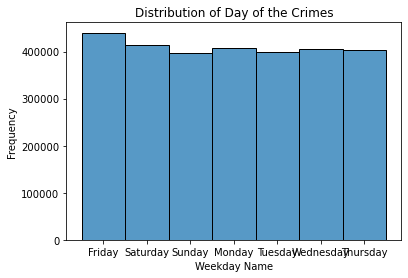

In [17]:
# Histogram for a numerical variable (e.g., time)
sns.histplot(crimedata['WEEKDAY_OCC'], bins=20, kde=False)

plt.xlabel('Weekday Name')
plt.ylabel('Frequency')
plt.title('Distribution of Day of the Crimes')
plt.show()


In [18]:
print(crimedata['WEEKDAY_OCC'].value_counts())

Friday       439981
Saturday     413875
Monday       408020
Wednesday    404640
Thursday     403980
Tuesday      399071
Sunday       396331
Name: WEEKDAY_OCC, dtype: int64


Over past 12 years, Friday is the highest crime incidents happened followed by Saturday. On the other hand,Sunday is the least crimes happened.

<b>What months have the most of the crimes recorded?</b>

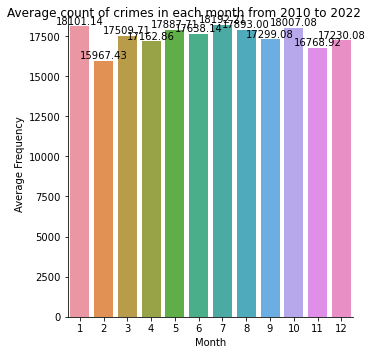

In [19]:

grouped_data = crimedata.groupby(['YEAR_OCC', 'MTH_OCC']).size().reset_index(name='Counts')
avg_monthly_counts = grouped_data.groupby('MTH_OCC')['Counts'].mean().reset_index()

# Create a Seaborn catplot
g = sns.catplot(x='MTH_OCC', y='Counts', data=avg_monthly_counts, kind='bar')

# Annotate each bar with its value
for ax in g.axes.flat:
    for patch in ax.patches:
        ax.annotate(f"{patch.get_height():.2f}", 
                    (patch.get_x() + patch.get_width() / 2., patch.get_height()), 
                    ha='center', va='center', 
                    xytext=(0, 5), 
                    textcoords='offset points')


g.set_xticklabels(range(1, 13))
g.set_axis_labels('Month', 'Average Frequency')
g.fig.suptitle('Average count of crimes in each month from 2010 to 2022')
plt.show()

In [20]:
print(crimedata['MTH_OCC'].value_counts())

7     254691
1     253416
8     250502
5     250428
6     246934
3     245136
4     240280
10    234092
9     224888
12    223991
2     223544
11    217996
Name: MTH_OCC, dtype: int64


Over 12 years, January is the highest crime rage on average.

<b>What year have the most of the crimes recorded?</b>

2022 has highest crime rate over 12 years

In [21]:
print(crimedata['YEAR_OCC'].value_counts())

2022    233425
2017    231103
2018    229117
2016    225379
2019    218114
2015    215351
2021    208794
2010    208695
2012    201297
2011    200300
2020    198721
2013    192367
2014    157470
2023    145765
Name: YEAR_OCC, dtype: int64


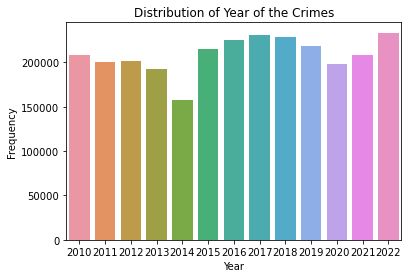

In [22]:
sns.countplot(data=crimedata, x='YEAR_OCC', order=range(2010, 2023))

plt.xlabel('Year')
plt.ylabel('Frequency')
plt.title('Distribution of Year of the Crimes')
plt.show()

#### 2.2.the crime incident description

In [23]:
#crimedata['CRM_CD_DESC'].unique()
print(crimedata['CRM_CD_DESC'].value_counts())

BATTERY - SIMPLE ASSAULT                                   249697
VEHICLE - STOLEN                                           240082
BURGLARY FROM VEHICLE                                      208545
BURGLARY                                                   192831
THEFT PLAIN - PETTY ($950 & UNDER)                         187623
                                                            ...  
TILL TAP - ATTEMPT                                              4
FIREARMS EMERGENCY PROTECTIVE ORDER (FIREARMS EPO)              4
TRAIN WRECKING                                                  2
FIREARMS TEMPORARY RESTRAINING ORDER (TEMP FIREARMS RO)         1
DRUNK ROLL - ATTEMPT                                            1
Name: CRM_CD_DESC, Length: 143, dtype: int64


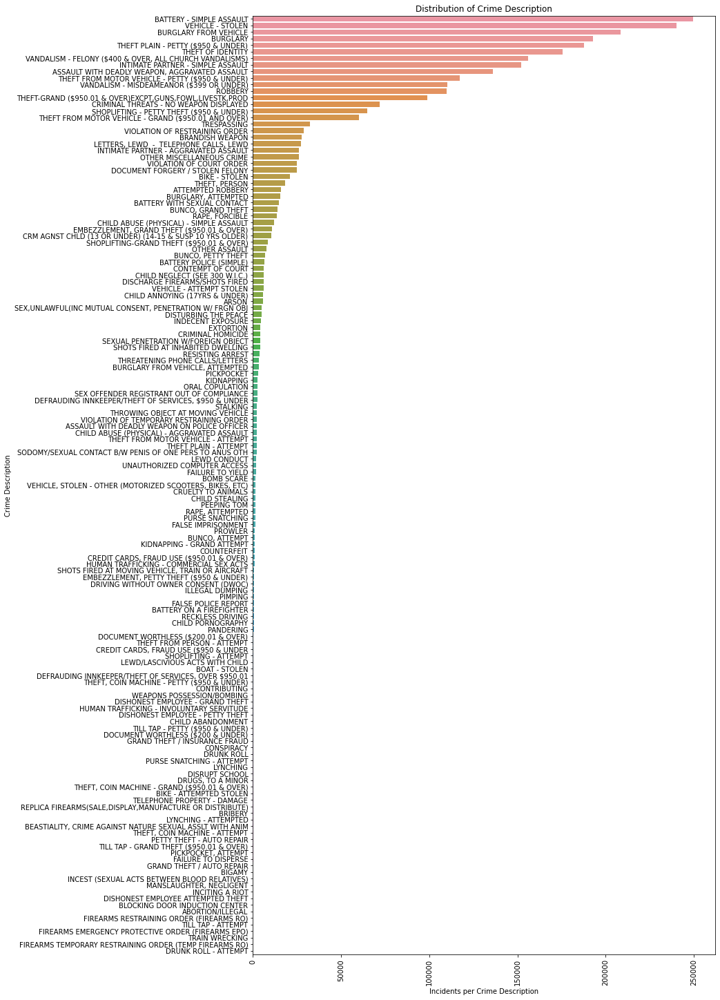

In [24]:
# Countplot for a categorical variable (e.g., description of crime)
plt.figure(figsize=(12, 25))  # Adjust the width (10) and height (20) as needed
sns.countplot(data=crimedata, y='CRM_CD_DESC',orient="h",order=crimedata['CRM_CD_DESC'].value_counts().index)

plt.xticks(rotation=90)
plt.ylabel('Crime Description')
plt.xlabel('Incidents per Crime Description')
plt.title('Distribution of Crime Description')
plt.show()

<b>Lets take a closer look with polar diagram on the 10 most common crimes over 12 years (2010 to 2022)</b>

In [25]:

fig = go.Figure(data=go.Scatterpolar(
  r=crimedata['CRM_CD_DESC'].value_counts().head(10),
  theta=crimedata['CRM_CD_DESC'].value_counts().head(10).index,
  fill='toself'
))

fig.update_layout(
    polar=dict(
        radialaxis=dict(
        visible=True
     ),
    ),
    showlegend=False,
    title_text="Top 10 LA Crime Record Radar Chart by Crime Desription",
    autosize=True
)

fig.show()

It appears that the most common type of is associated with assult, followed by theif and burglary.

In [26]:

# Identify top 10 most frequent values in colA
top_10_values = crimedata['CRM_CD_DESC'].value_counts().head(10).index

# Filter the original DataFrame
top_10_crimes = crimedata[crimedata['CRM_CD_DESC'].isin(top_10_values)]


print(top_10_crimes.head(1))
top_10_crimes.shape



              DATE_OCC  TIME_OCC  AREA AREA_NAME  RPT_DIST_NO  PART_1-2  \
DATE_RPTD                                                                 
2019-07-31  2010-01-01       900    21   Topanga         2175         2   

            CRM_CD        CRM_CD_DESC MOCODES  VICT_AGE  ...     LAT  \
DATE_RPTD                                                ...           
2019-07-31     354  THEFT OF IDENTITY    0377        48  ...  34.172   

                 LON  MTH_RPTD DAY_RPTD  YEAR_RPTD MTH_OCC DAY_OCC YEAR_OCC  \
DATE_RPTD                                                                     
2019-07-31 -118.6084         7       31       2019       1       1     2010   

            ID WEEKDAY_OCC  
DATE_RPTD                   
2019-07-31   1      Friday  

[1 rows x 30 columns]


(1816075, 30)

In [27]:
top_10_crimes.head().T

DATE_RPTD,2019-07-31,2011-07-21,2014-07-21,2013-05-07,2011-12-20
DATE_OCC,2010-01-01,2010-01-01,2010-01-01,2010-01-01,2010-01-01
TIME_OCC,900,800,10,1,1
AREA,21,11,20,16,20
AREA_NAME,Topanga,Northeast,Olympic,Foothill,Olympic
RPT_DIST_NO,2175,1112,2002,1667,2093
PART_1-2,2,2,2,2,2
CRM_CD,354,354,354,354,354
CRM_CD_DESC,THEFT OF IDENTITY,THEFT OF IDENTITY,THEFT OF IDENTITY,THEFT OF IDENTITY,THEFT OF IDENTITY
MOCODES,0377,NaN,0100 1822 0917,1822 0100,1202 0100
VICT_AGE,48,55,42,57,74


Below graphs indicate the average number of incidents happened by years and day of the week for top 10 of the crimes. It shows that different crimes have different frequency at the different timing. 

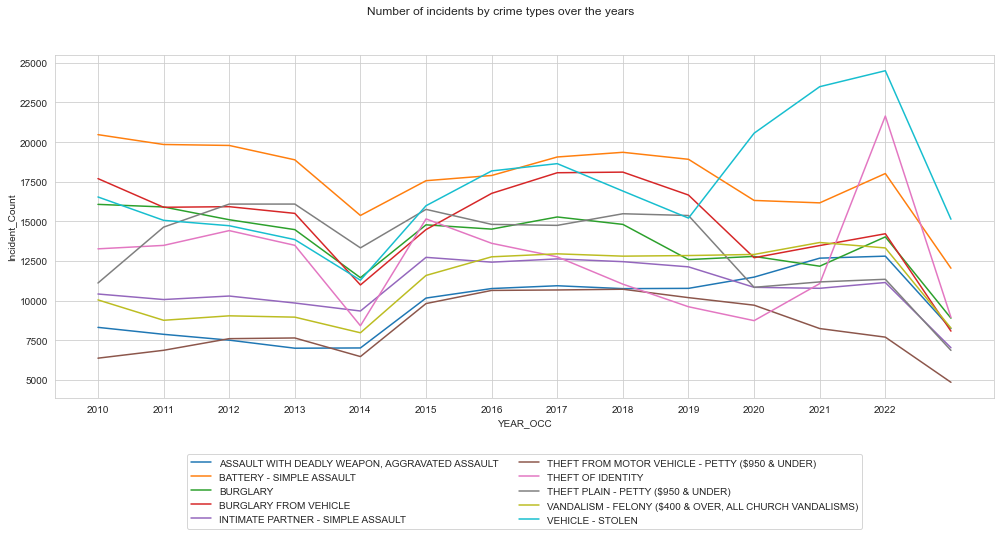

In [28]:

data_yearvscrimes = top_10_crimes.groupby(['YEAR_OCC', 'CRM_CD_DESC']).size().reset_index(name='Incident_Count')

sns.set_style("whitegrid")
fig, ax = plt.subplots(figsize=(14, 8))

# Plotting the Incident_Count over years for each crime description
ax = sns.lineplot(x='YEAR_OCC', y='Incident_Count', data=data_yearvscrimes, hue='CRM_CD_DESC')

# Assuming that 'YEAR_OCC' has year values, you wouldn't set crime descriptions as x-tick labels.
# Instead, handle the legend to avoid label cluttering.
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=2) 
# Setting xticks from 2010 to 2022
ax.set_xticks(list(range(2010, 2023)))
ax.set_xticklabels(list(range(2010, 2023)))

plt.suptitle('Number of incidents by crime types over the years')
fig.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

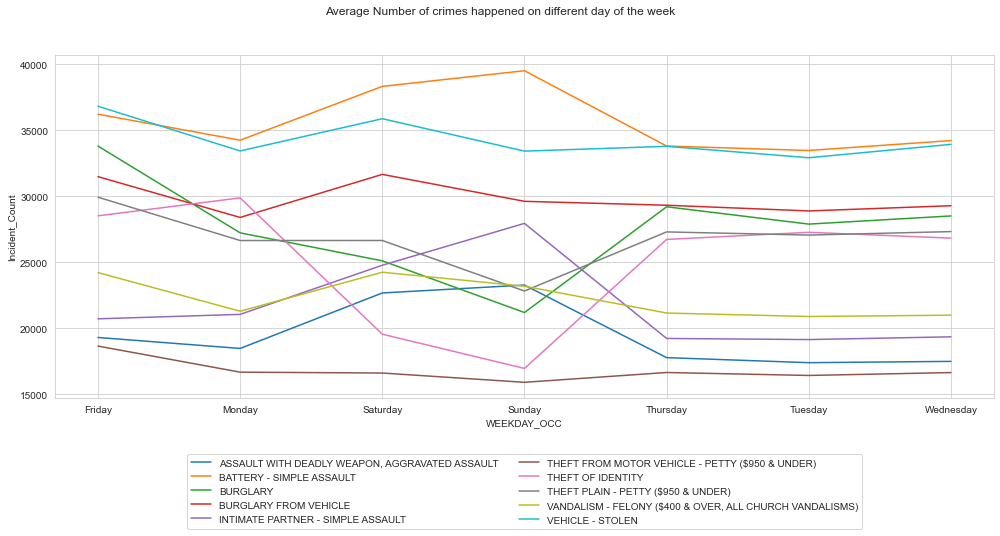

In [29]:
data_weekdayvscrimes = top_10_crimes.groupby(['WEEKDAY_OCC', 'CRM_CD_DESC']).size().reset_index(name='Incident_Count')

sns.set_style("whitegrid")
fig, ax = plt.subplots(figsize=(14, 8))


ax = sns.lineplot(x='WEEKDAY_OCC', y='Incident_Count', data=data_weekdayvscrimes, hue='CRM_CD_DESC')


ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=2) 

plt.suptitle('Average Number of crimes happened on different day of the week')
fig.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

Regardless "Battery - simple assult" has highest incidents from the past 12 years,the trend is not consistent in recent years. On the other hands, "Assult with deadly weapon" incidents are  heading to upward trends among the other crimes.


array([[<AxesSubplot:xlabel='DATE_OCC'>, <AxesSubplot:xlabel='DATE_OCC'>],
       [<AxesSubplot:xlabel='DATE_OCC'>, <AxesSubplot:xlabel='DATE_OCC'>],
       [<AxesSubplot:xlabel='DATE_OCC'>, <AxesSubplot:xlabel='DATE_OCC'>],
       [<AxesSubplot:xlabel='DATE_OCC'>, <AxesSubplot:xlabel='DATE_OCC'>],
       [<AxesSubplot:xlabel='DATE_OCC'>, <AxesSubplot:xlabel='DATE_OCC'>]],
      dtype=object)

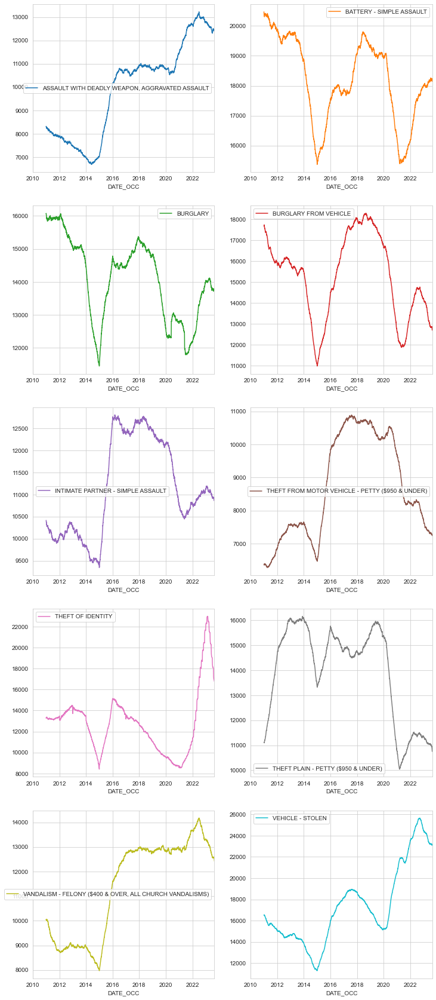

In [30]:
crimes_count_date = top_10_crimes.pivot_table('ID', aggfunc=np.size, columns='CRM_CD_DESC', index=top_10_crimes['DATE_OCC'], fill_value=0)
crimes_count_date.index = pd.DatetimeIndex(crimes_count_date.index)
crimes_count_date.rolling(365).sum().plot(figsize=(12, 30), subplots=True, layout=(-1, 2), sharex=False, sharey=False)


### 2.3 Area & Location 

Lets see distrubution based on crime area within LA county. It indicates that 77th Street is the highest crime rate and Foothill has the lowest crime rate.

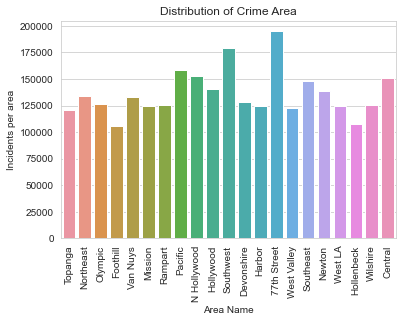

In [31]:
# Countplot for a categorical variable 
sns.countplot(data=crimedata, x='AREA_NAME')
plt.xticks(rotation=90)
plt.xlabel('Area Name')
plt.ylabel('Incidents per area')
plt.title('Distribution of Crime Area')
plt.show()

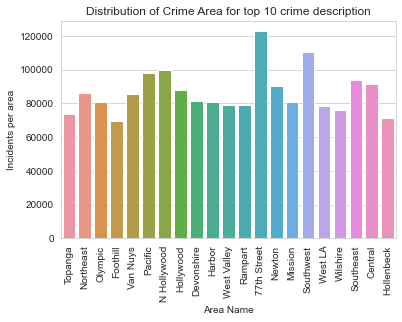

In [32]:
sns.countplot(data=top_10_crimes, x='AREA_NAME')
plt.xticks(rotation=90)
plt.xlabel('Area Name')
plt.ylabel('Incidents per area')
plt.title('Distribution of Crime Area for top 10 crime description')
plt.show()

<b>How is the outlook of location distrubution based on coordinate ? </b>

In [33]:
import requests

api_url = "https://services5.arcgis.com/7nsPwEMP38bSkCjy/arcgis/rest/services/LAPD_Division/FeatureServer/0/query?outFields=*&where=1%3D1&f=geojson"
response = requests.get(api_url)
data = response.json()

# Create a base map (default location and zoom set to thhttp://localhost:8888/notebooks/Documents/GitHub/DataScienceCapstone2/notebooks/Exploratory_data_analysis.ipynb#e whole world for this example)
lamap = folium.Map(location=[20, 0], zoom_start=2)

# Add the GeoJSON data to the map
folium.GeoJson(data).add_to(lamap)



# Save the map to an HTML file (optional)
lamap.save("lamap.html")


Top 10 Crime investigation based on location data</br>
Based on heatmap overview, Downtown LA area is significantly high of crime rates compared to other areas.

In [34]:
from folium.plugins import HeatMap

top_10_crimes.rename(columns={'LAT':'latitude','LON':'longitude'}, inplace=True)
HeatMap(data=top_10_crimes[['latitude', 'longitude']], radius=16).add_to(lamap)

lamap

/Users/thantthiri/opt/anaconda3/lib/python3.9/site-packages/pandas/core/frame.py:4441: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



### 3.Feature Correlation Heatmap


If 2 variables are correlated to each other by:</br>
0.0 to 0.3, they are weakly correlated,</br>
0.3 to 0.6, they are moderately correlated,</br>
0.6 to 0.9, they are strongly correlated,</br>
finally, >0.9, they are very strongly correlated

<b>Lets see Generic Correlation on crime data on all columns</b></br>

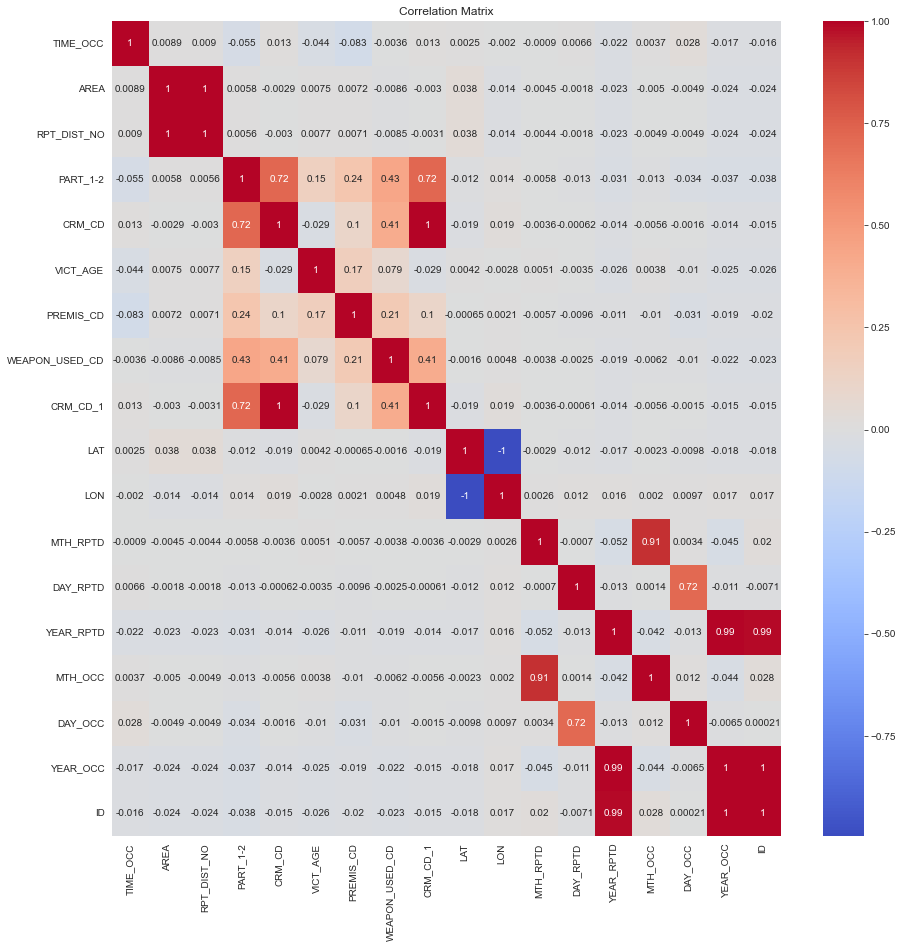

In [35]:
# Calculate Pearson correlation matrix
correlation_matrix = crimedata.corr()

# Visualize the correlation matrix using a heatmap
plt.figure(figsize=(15, 15))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

Pivot dataframe based on top 10 crime description.

In [36]:
pvdf_top_10_crimes = top_10_crimes.pivot_table(index=['YEAR_OCC', 'MTH_OCC', 'WEEKDAY_OCC', 'AREA_NAME'], columns=top_10_crimes['CRM_CD_DESC'], values='ID', aggfunc='sum').reset_index()
pvdf_top_10_crimes.head(3)

CRM_CD_DESC,YEAR_OCC,MTH_OCC,WEEKDAY_OCC,AREA_NAME,"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT",BATTERY - SIMPLE ASSAULT,BURGLARY,BURGLARY FROM VEHICLE,INTIMATE PARTNER - SIMPLE ASSAULT,THEFT FROM MOTOR VEHICLE - PETTY ($950 & UNDER),THEFT OF IDENTITY,THEFT PLAIN - PETTY ($950 & UNDER),"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VANDALISMS)",VEHICLE - STOLEN
0,2010,1,Friday,77th Street,119370.0,204571.0,172617.0,111413.0,73330.0,51845.0,133389.0,109575.0,90086.0,111538.0
1,2010,1,Friday,Central,29337.0,156939.0,24285.0,106162.0,54402.0,2240.0,75406.0,95163.0,38015.0,12706.0
2,2010,1,Friday,Devonshire,14141.0,115605.0,130391.0,233702.0,20266.0,21067.0,146778.0,66635.0,78519.0,98599.0


In [37]:
# Make a pairplot of the top 10 crime data
#plt.figure(figsize=(40,20))
#sns.pairplot(pvdf_top_10_crimes)
#plt.show()

In [38]:
# Make a pairplot of the top  10 crime data
top_10_crimes_matrix =pvdf_top_10_crimes.corr()
top_10_crimes_matrix

CRM_CD_DESC,YEAR_OCC,MTH_OCC,"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT",BATTERY - SIMPLE ASSAULT,BURGLARY,BURGLARY FROM VEHICLE,INTIMATE PARTNER - SIMPLE ASSAULT,THEFT FROM MOTOR VEHICLE - PETTY ($950 & UNDER),THEFT OF IDENTITY,THEFT PLAIN - PETTY ($950 & UNDER),"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VANDALISMS)",VEHICLE - STOLEN
CRM_CD_DESC,,,,,,,,,,,,
YEAR_OCC,1.000000,-0.048062,0.629745,0.696622,0.638649,0.574427,0.670057,0.680454,0.502154,0.606368,0.760386,0.768384
MTH_OCC,-0.048062,1.000000,0.034553,0.035852,0.035177,0.023525,0.040145,0.015186,-0.021922,0.058252,0.015969,0.030635
"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT",0.629745,0.034553,1.000000,0.658480,0.308170,0.396699,0.660603,0.413969,0.358608,0.379023,0.596975,0.680613
BATTERY - SIMPLE ASSAULT,0.696622,0.035852,0.658480,1.000000,0.423709,0.596481,0.610579,0.478485,0.366882,0.578721,0.659828,0.604694
BURGLARY,0.638649,0.035177,0.308170,0.423709,1.000000,0.461810,0.371053,0.529564,0.421488,0.524789,0.549720,0.473049
BURGLARY FROM VEHICLE,0.574427,0.023525,0.396699,0.596481,0.461810,1.000000,0.374040,0.438803,0.287493,0.607659,0.585365,0.406168
INTIMATE PARTNER - SIMPLE ASSAULT,0.670057,0.040145,0.660603,0.610579,0.371053,0.374040,1.000000,0.506128,0.372605,0.380118,0.585422,0.651664
THEFT FROM MOTOR VEHICLE - PETTY ($950 & UNDER),0.680454,0.015186,0.413969,0.478485,0.529564,0.438803,0.506128,1.000000,0.394851,0.481907,0.555615,0.556490
THEFT OF IDENTITY,0.502154,-0.021922,0.358608,0.366882,0.421488,0.287493,0.372605,0.394851,1.000000,0.337592,0.414296,0.478156


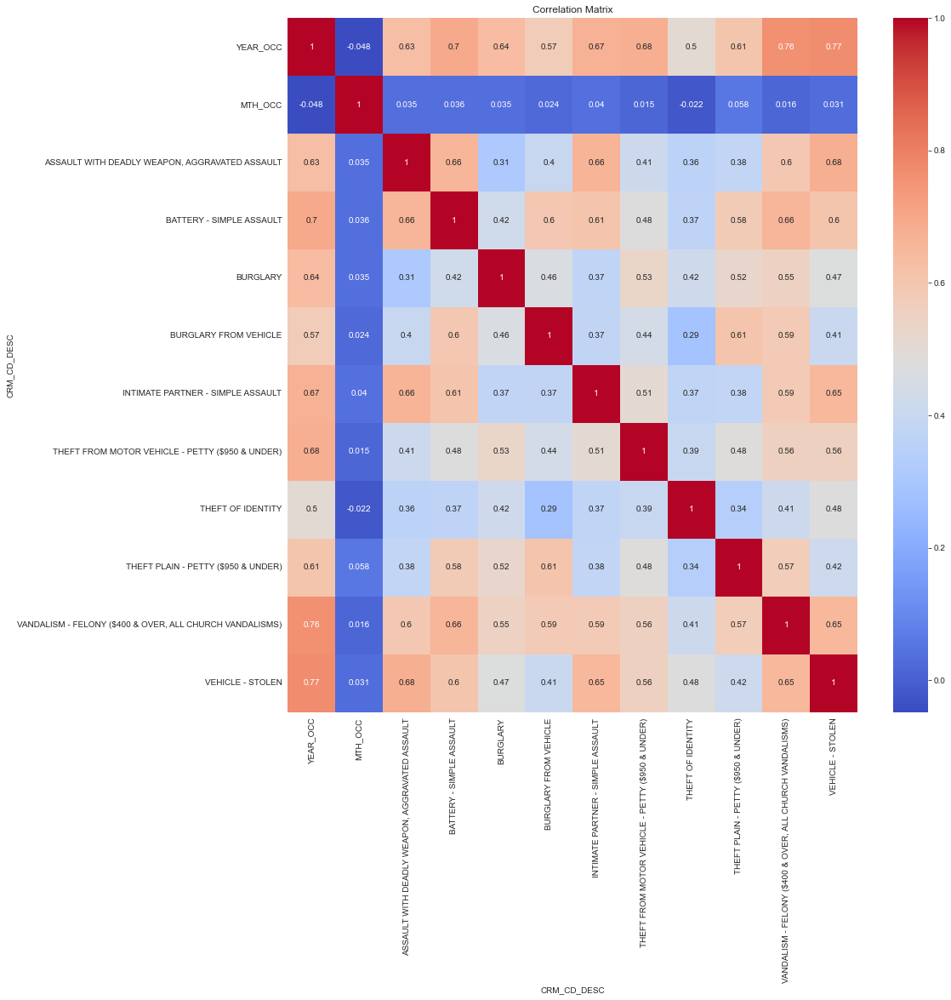

In [39]:
# Visualize the correlation matrix using a heatmap
plt.figure(figsize=(15, 15))
sns.heatmap(top_10_crimes_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

In [40]:
dayofweek_by_area = top_10_crimes.pivot_table(values='ID', index='AREA_NAME', columns=top_10_crimes['WEEKDAY_OCC'], aggfunc=np.size).fillna(0)
dayofweek_by_area.head(3)

WEEKDAY_OCC,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday
AREA_NAME,,,,,,,
77th Street,18235,17841,17715,17609,17025,16987,17199
Central,14047,12330,14644,13052,12729,12231,12359
Devonshire,12971,11597,11294,10543,11654,11395,11702


In [41]:
dayofweek_by_crime = top_10_crimes.pivot_table(values='ID', index='CRM_CD_DESC', columns=top_10_crimes['WEEKDAY_OCC'], aggfunc=np.size).fillna(0)
dayofweek_by_crime.head(3)

WEEKDAY_OCC,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday
CRM_CD_DESC,,,,,,,
"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT",19286,18455,22658,23256,17758,17377,17475
BATTERY - SIMPLE ASSAULT,36204,34234,38311,39497,33791,33454,34206
BURGLARY,33790,27213,25094,21176,29188,27876,28494


In [42]:
area_by_crime  = top_10_crimes.pivot_table(values='ID', index='AREA_NAME', columns=top_10_crimes['CRM_CD_DESC'], aggfunc=np.size).fillna(0)
area_by_crime.head(3)

CRM_CD_DESC,"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT",BATTERY - SIMPLE ASSAULT,BURGLARY,BURGLARY FROM VEHICLE,INTIMATE PARTNER - SIMPLE ASSAULT,THEFT FROM MOTOR VEHICLE - PETTY ($950 & UNDER),THEFT OF IDENTITY,THEFT PLAIN - PETTY ($950 & UNDER),"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VANDALISMS)",VEHICLE - STOLEN
AREA_NAME,,,,,,,,,,
77th Street,16701,18829,11310,9033,13267,6211,10133,8345,9430,19352
Central,9122,20493,4837,15156,5992,3019,3984,13984,7995,6810
Devonshire,3178,8601,12401,10480,5665,6669,11007,7823,6511,8821


Making wrapper functions to make some minimal preprocessing and make the heatmap visualization. It is to make heatmaps nicer looking is to use a clustering algorithm to sort the rows into meaningful groups and use group labels to re-sort our matrix.

In [43]:

def scale_df(df,axis=0):
    '''
    A utility function to scale numerical values (z-scale) to have a mean of zero
    and a unit variance.
    '''
    return (df - df.mean(axis=axis)) / df.std(axis=axis)

def plot_hmap(df, ix=None, cmap='bwr'):
    '''
    A function to plot heatmaps that show temporal patterns
    '''
    if ix is None:
        ix = np.arange(df.shape[0])
    plt.imshow(df.iloc[ix,:], cmap=cmap)
    plt.colorbar(fraction=0.03)
    plt.yticks(np.arange(df.shape[0]), df.index[ix])
    plt.xticks(np.arange(df.shape[1]))
    plt.grid(False)
    plt.show()
    
    
def normalize(df):
    result = df.copy()
    for feature_name in df.columns:
        max_value = df[feature_name].max()
        min_value = df[feature_name].min()
        result[feature_name] = (df[feature_name] - min_value) / (max_value - min_value)
    return result

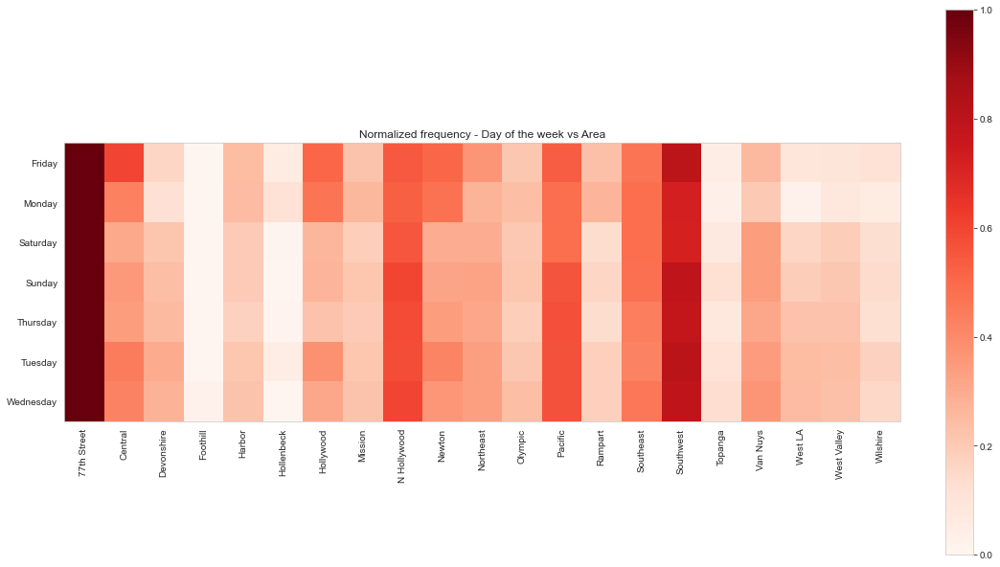

In [44]:
df = normalize(dayofweek_by_area)
ix = AC(3).fit(df.T).labels_.argsort() # a trick to make better heatmaps
plt.figure(figsize=(17,13))
plt.imshow(df.T.iloc[ix,:], cmap='Reds')
plt.colorbar(fraction=0.03)
plt.xticks(np.arange(df.shape[0]), df.index, rotation='vertical')
plt.yticks(np.arange(df.shape[1]), df.columns)
plt.title('Normalized frequency - Day of the week vs Area')
plt.grid(False)
plt.show()


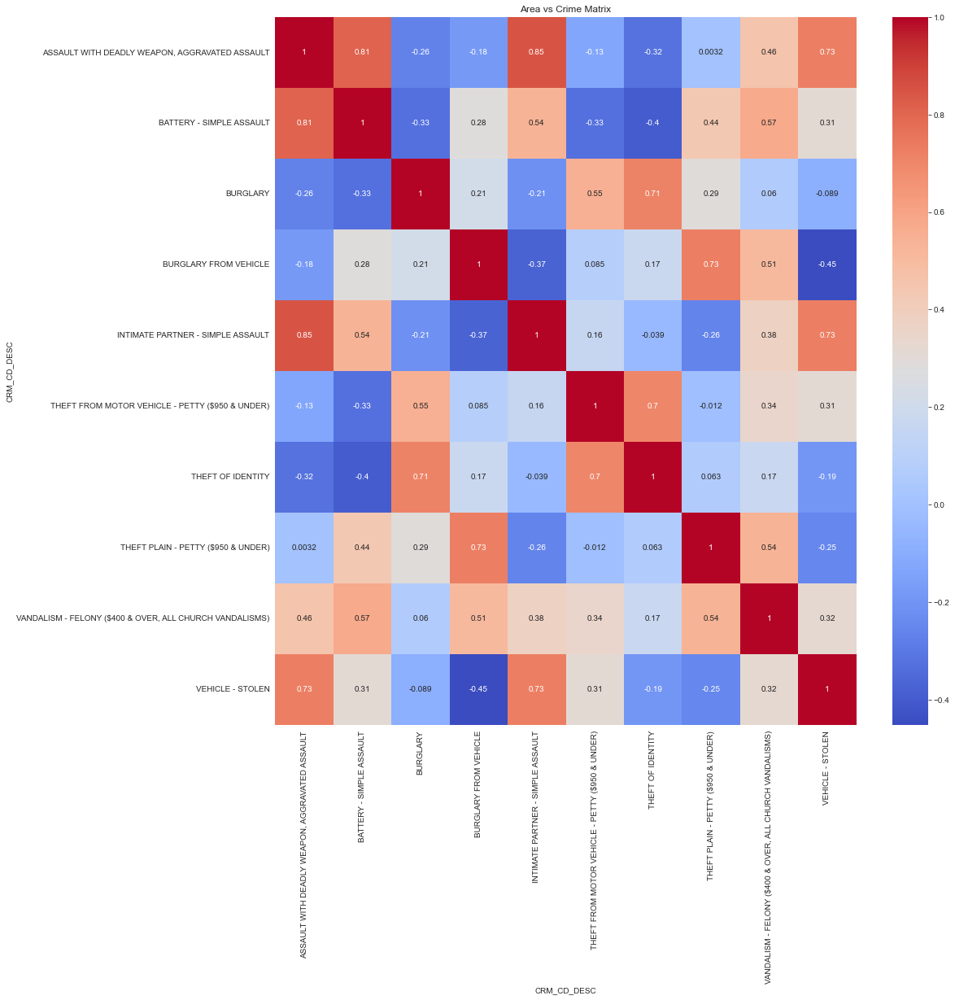

In [45]:
# Calculate Pearson correlation matrix
corr_area_by_crime = area_by_crime.corr()

# Visualize the correlation matrix using a heatmap
plt.figure(figsize=(16, 16))
sns.heatmap(corr_area_by_crime, annot=True, cmap='coolwarm')
plt.title('Area vs Crime Matrix')
plt.show()

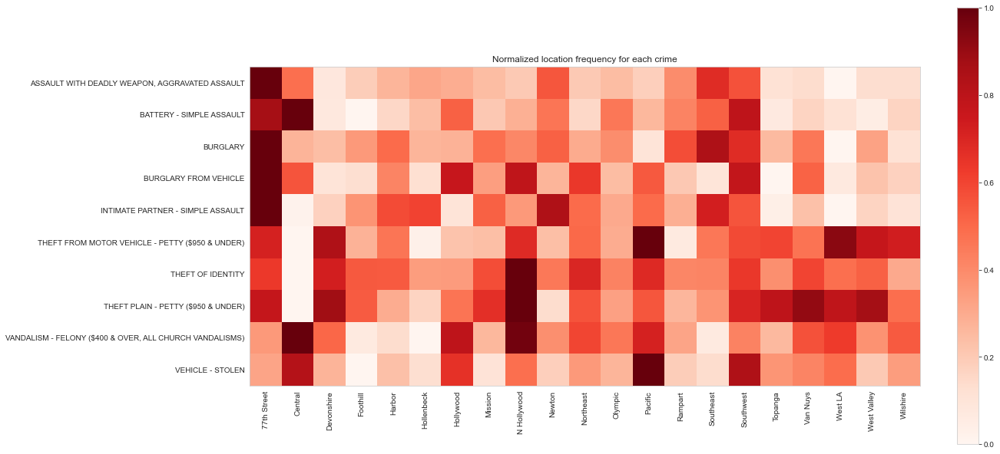

In [46]:
df = normalize(area_by_crime)
ix = AC(3).fit(df.T).labels_.argsort() # a trick to make better heatmaps
plt.figure(figsize=(17,13))
plt.imshow(df.T.iloc[ix,:], cmap='Reds')
plt.colorbar(fraction=0.03)
plt.xticks(np.arange(df.shape[0]), df.index, rotation='vertical')
plt.yticks(np.arange(df.shape[1]), df.columns)
plt.title('Normalized location frequency for each crime')
plt.grid(False)
plt.show()

Taking each crime type and re-normalize its location frequency to be between zero and one. This way, we can look at the top frequent locations of each crime type (darker red reflect a more frequent location).

### Save Data

In [47]:
# Specify the file path where you want to save the CSV file
file_path = "../data/interim/" + "top_10_crime_data.csv"

# Save the DataFrame to a CSV file
top_10_crimes.to_csv(file_path, index=False)  # Set index=False to exclude the DataFrame index in the CSV file

### Summary

This ends the EDA of top 10 freqents crimes over 12 years and the charts, numbers, and data indicate some of the crimes have been reported an upward trend, some are downword. But , Downtown LA (77th Street) area is all-time-high crime rate consistantly.</br>
Future Work:</br>
To forecast crime data for the next years - to predict the probability of first 10 crime type based on the area and day of the week.